# The diffusion equation
Numerical solution of the 1D diffusion problem
$$ \frac{\partial N}{\partial t} =  k \frac{\partial^2 N}{\partial x^2}$$ 
using an explicit scheme

$N(x,t)$ represents the evolution of the dissolved nitrogen (DIN) concentration along the estuary over time

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
# constants
SECPERDAY = 86400.
M2KM = 1000

## User defined parameters

In [2]:
# problem parameters
kappa=1.0e3   # Eddy diffusion coefficient [m2 s-1]
dx=500         # X resolution [m]
dt=100         # time step [s]
t0=0.          # initial time
tmax=0.12      # duration of simulation [days]
xmax=10.0e3    # length of the basin [m]

# Parameters of the initial DIN spillage
N0 = 20.       # baseline concentration [mmol/m3]
sigma = 1000.  # width [m]
A = 100.       # amplitude [mmol/m3]

## Initial function and grid specifications
The initial shape of the temperature distribution is a Gaussian peak function

In [3]:
# Spatial shape of the initial DIN concentration
def Gaussian(x):
    y = N0+A*np.exp(-(x/sigma)**2)
    return y

The resulting space-time grid depends on the parameters above. The non-dimensional Courant number must be smaller than 0.5 for conditional stability.

In [4]:
# time axis
NT = int(np.floor(tmax*86400/dt))+1  # number of steps (starts from 0)
# X axis (centred at 0)
x = np.arange(-xmax,xmax,dx)
IM = len(x)             # number of grid points
N = np.zeros([IM,NT])   # the array holding the numerical solution 
print('Grid steps : ',IM)
print('Number of time steps : ',NT)
print('Timestep = ',dt,' s')
print('Max numerical diffusion DX^2/DT = ',dx**2/dt,' m2/s')
print('Physical diffusion = ',kappa,' m2/s')
print('Courant number (diffusion) = ',kappa*dt/(dx**2))

Grid steps :  40
Number of time steps :  104
Timestep =  100  s
Max numerical diffusion DX^2/DT =  2500.0  m2/s
Physical diffusion =  1000.0  m2/s
Courant number (diffusion) =  0.4


## Numerical solution
Note that this code stores the solution at all times in array N for educational purposes. This allows to plot the solution at the different time steps and see how it evolves.

*This method is very inefficient for any application because it uses a lot of memory. In modern computer codes only a few time records are hold in memory. The instantaneous solution is often temporarely stored for computing time averages and then discarded.*

This part of the code is the topic of one question found in the lecture notes

In [5]:
# Compute the numerical solution using a time loop over the number of time steps
N[:,0] = Gaussian(x)    # initial condition

for n in range(NT-1):
    # Question 2
    N[0,n+1]  = N[1,n]
    N[-1,n+1] = N[-2,n]
    # discretization of the second derivative
    rhs = kappa*(N[:-2,n]-2*N[1:-1,n]+N[2:,n])/(dx**2)
    N[1:-1,n+1] = N[1:-1,n] + rhs*dt    

## Plot the result using a matplotlib animation
The animation below displays the evolution of the solution and compares it with the initial condition

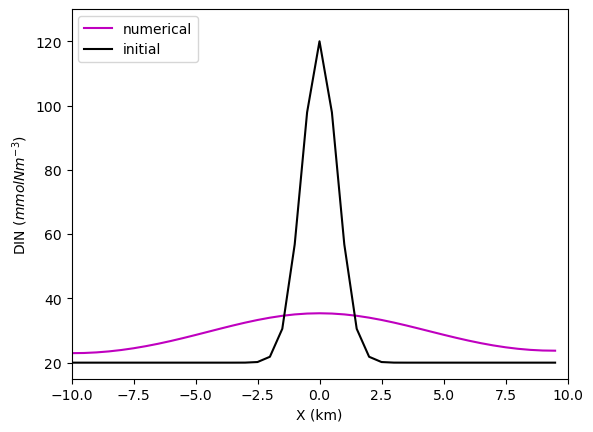

In [6]:
fig, ax = plt.subplots()
# set the axis limits
plt.axis([-xmax/M2KM, xmax/M2KM, N0-5, N0+A+10])
# first plot the initial condition and set the line attributes
sol, = ax.plot(x/M2KM, N[:,0],'m',label='numerical')
line, = ax.plot(x/M2KM, Gaussian(x),'k',label='initial')
ax.set_xlabel('X (km)')
ax.set_ylabel('DIN ($mmol N m^{-3}$)')
plt.legend(loc='upper left')

def animate(i):
    sol.set_ydata(N[:,i])  # update the numerical solution
    return sol,

# create the animation and loop (interval is in ms)
ani = animation.FuncAnimation(
    fig, animate, interval=dt, blit=True, frames=NT, repeat=True)

# display the animation as a javascript object embedded in the notebook
from IPython.display import HTML
HTML(ani.to_jshtml())

# Optimized diffusion solution code

In [7]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

SECPERDAY = 86400.
M2KM = 1000

def run_diffusion_model(
    kappa=1.0e3, dx=500, dt=100, tmax=0.12, xmax=10.0e3,
    N0=20., sigma=1000., A=100.,
    boundary_condition='neumann'  # options: 'neumann', 'dirichlet'
):
    # Time and space setup
    NT = int(np.floor(tmax * SECPERDAY / dt)) + 1
    x = np.arange(-xmax, xmax, dx)
    IM = len(x)
    N = np.zeros([IM, NT])

    print('Grid steps : ', IM)
    print('Number of time steps : ', NT)
    print('Timestep = ', dt, ' s')
    print('Max numerical diffusion DX^2/DT = ', dx**2 / dt, ' m2/s')
    print('Physical diffusion = ', kappa, ' m2/s')
    print('Courant number (diffusion) = ', kappa * dt / (dx**2))

    # Initial condition
    def Gaussian(x): return N0 + A * np.exp(-(x / sigma)**2)
    N[:, 0] = Gaussian(x)

    # Time stepping loop
    for n in range(NT - 1):
        if boundary_condition == 'neumann':  # zero-flux at boundaries
            N[0, n + 1] = N[1, n]
            N[-1, n + 1] = N[-2, n]
        elif boundary_condition == 'dirichlet':  # fixed value at boundaries
            N[0, n + 1] = N0
            N[-1, n + 1] = N0
        else:
            raise ValueError("Unknown boundary_condition. Use 'neumann' or 'dirichlet'.")

        rhs = kappa * (N[:-2, n] - 2 * N[1:-1, n] + N[2:, n]) / dx**2
        N[1:-1, n + 1] = N[1:-1, n] + rhs * dt

    # Visualization
    fig, ax = plt.subplots()
    plt.axis([-xmax / M2KM, xmax / M2KM, N0 - 5, N0 + A + 10])
    sol, = ax.plot(x / M2KM, N[:, 0], 'm', label='numerical')
    line, = ax.plot(x / M2KM, Gaussian(x), 'k', label='initial')
    ax.set_xlabel('X (km)')
    ax.set_ylabel('DIN ($mmol N m^{-3}$)')
    plt.legend(loc='upper left')

    def animate(i):
        sol.set_ydata(N[:, i])
        return sol,

    ani = animation.FuncAnimation(fig, animate, interval=dt, blit=True, frames=NT, repeat=True)
    return HTML(ani.to_jshtml())

In [8]:
print(f'Courant number: {kappa*dt/dx**2:.2f} (should be < 0.5)')
print(f'Grid spacing vs diffusion scale: {dx} m vs {np.sqrt(kappa*dt):.1f} m')

Courant number: 0.40 (should be < 0.5)
Grid spacing vs diffusion scale: 500 m vs 316.2 m


# Question 1 - Why does the flattening of the peak slow down with time?

The rate of diffusion depends on the strength of the horizontal DIN gradient. This gradient, and so the rate of diffusion, weakens as time progresses. This is a direct result of the diffusion itself.  

# Question 2 

## How would you describe Neumann conditions? 

This is where the spatial derivative of DIN is equal to zero at the boundary. This means that the rate of diffusion at the boundary is zero, thus there is no diffusion of DIN across the boundary.

The left and right boundaries are approximated by setting their values equal to the adjacent (interior) value: `N[0, n+1]  = N[1, n]` and `N[-1, n+1] = N[-2, n]`. This method works, because the rate of diffusion (gradient) between two equal values is zero. 

##  Why do you think the Neumann boundary conditions are more realistic?

With Dirichlet Conditions the concentration of DIN at the boundaries does not change over time. This seems unrealistic to me, especially since we are looking at a *closed* estuary system. If there is an increase in DIN , it should diffuse throughout the entire system, and increase the concentration of DIN throughout the system, even at the boundaries.

## Optimized solution with Nuemann Conditions 

Grid steps :  40
Number of time steps :  104
Timestep =  100  s
Max numerical diffusion DX^2/DT =  2500.0  m2/s
Physical diffusion =  1000.0  m2/s
Courant number (diffusion) =  0.4


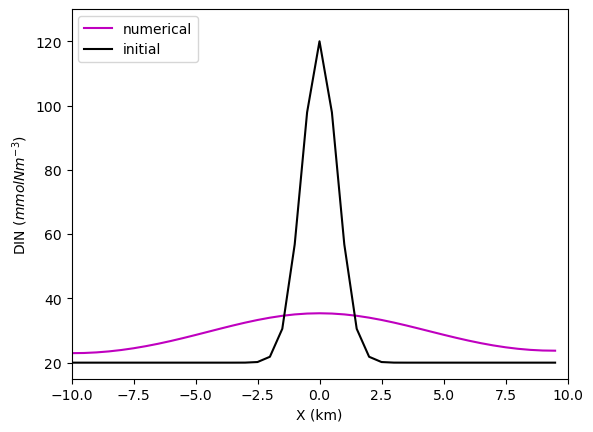

In [9]:
run_diffusion_model(
    kappa=1.0e3,      # Eddy diffusion coefficient [m^2/s]
    dx=500,           # Spatial resolution [m]
    dt=100,           # Time step [s]
    tmax=0.12,        # Duration [days]
    xmax=10.0e3,      # Half-length of the basin [m]
    N0=20.,           # Baseline DIN concentration [mmol/m^3]
    sigma=1000.,      # Gaussian width [m]
    A=100.,           # Gaussian amplitude [mmol/m^3]
    boundary_condition='neumann'  # Zero-gradient at boundaries
)

## Optimized solution with Dirichlet Conditions 

Grid steps :  40
Number of time steps :  104
Timestep =  100  s
Max numerical diffusion DX^2/DT =  2500.0  m2/s
Physical diffusion =  1000.0  m2/s
Courant number (diffusion) =  0.4


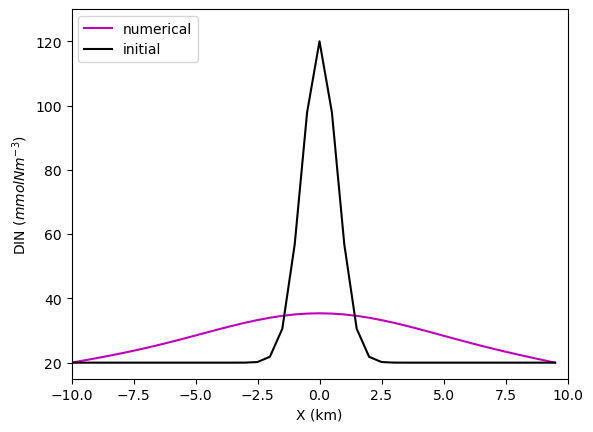

In [10]:
run_diffusion_model(
    kappa=1.0e3,      # Eddy diffusion coefficient [m^2/s]
    dx=500,           # Spatial resolution [m]
    dt=100,           # Time step [s]
    tmax=0.12,        # Duration [days]
    xmax=10.0e3,      # Half-length of the basin [m]
    N0=20.,           # Baseline DIN concentration [mmol/m^3]
    sigma=1000.,      # Gaussian width [m]
    A=100.,           # Gaussian amplitude [mmol/m^3]
    boundary_condition='dirichlet'  # Fixed value at boundaries
)

# Question 3 

## What happens if you double the diffusivity coefficient?

The solution becomes very unstable. 

## What would you do to fix it and why?

I would halve the time step, and now evaluate the function every 50 seconds. This decreases the Courant number (diffusion) back to 0.4.

Grid steps :  40
Number of time steps :  208
Timestep =  50  s
Max numerical diffusion DX^2/DT =  5000.0  m2/s
Physical diffusion =  2000.0  m2/s
Courant number (diffusion) =  0.4


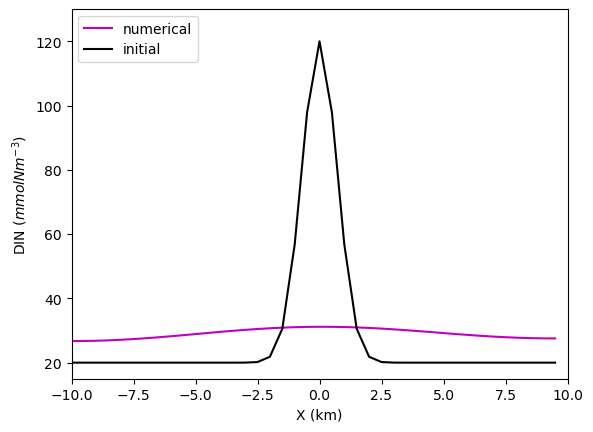

In [11]:
run_diffusion_model(
    kappa=2.0e3,      # Eddy diffusion coefficient [m^2/s]
    dx=500,           # Spatial resolution [m]
    dt=50,           # Time step [s]
    tmax=0.12,        # Duration [days]
    xmax=10.0e3,      # Half-length of the basin [m]
    N0=20.,           # Baseline DIN concentration [mmol/m^3]
    sigma=1000.,      # Gaussian width [m]
    A=100.,           # Gaussian amplitude [mmol/m^3]
    boundary_condition='neumann'  # Zero-gradient at boundaries
)

# Use of AI 

I created a python script with the code from the diffusion notebook. I attached the script and then prompted it as below:

#### My prompt to ChatGPT: Make the model a function into which you can input different initial conditions, boundary conditions and model parameters.

To make your diffusion model more flexible and reusable, we can convert it into a function that accepts the **initial conditions**, **boundary conditions**, and **model parameters** as arguments. Here's a refactored version of your script that encapsulates everything into a function:

```python
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

SECPERDAY = 86400.
M2KM = 1000

def run_diffusion_model(
    kappa=1.0e3, dx=500, dt=100, tmax=0.12, xmax=10.0e3,
    N0=20., sigma=1000., A=100.,
    boundary_condition='neumann'  # options: 'neumann', 'dirichlet'
):
    # Time and space setup
    NT = int(np.floor(tmax * SECPERDAY / dt)) + 1
    x = np.arange(-xmax, xmax, dx)
    IM = len(x)
    N = np.zeros([IM, NT])

    print('Grid steps : ', IM)
    print('Number of time steps : ', NT)
    print('Timestep = ', dt, ' s')
    print('Max numerical diffusion DX^2/DT = ', dx**2 / dt, ' m2/s')
    print('Physical diffusion = ', kappa, ' m2/s')
    print('Courant number (diffusion) = ', kappa * dt / (dx**2))

    # Initial condition
    def Gaussian(x): return N0 + A * np.exp(-(x / sigma)**2)
    N[:, 0] = Gaussian(x)

    # Time stepping loop
    for n in range(NT - 1):
        if boundary_condition == 'neumann':  # zero-flux at boundaries
            N[0, n + 1] = N[1, n]
            N[-1, n + 1] = N[-2, n]
        elif boundary_condition == 'dirichlet':  # fixed value at boundaries
            N[0, n + 1] = N0
            N[-1, n + 1] = N0
        else:
            raise ValueError("Unknown boundary_condition. Use 'neumann' or 'dirichlet'.")

        rhs = kappa * (N[:-2, n] - 2 * N[1:-1, n] + N[2:, n]) / dx**2
        N[1:-1, n + 1] = N[1:-1, n] + rhs * dt

    # Visualization
    fig, ax = plt.subplots()
    plt.axis([-xmax / M2KM, xmax / M2KM, N0 - 5, N0 + A + 10])
    sol, = ax.plot(x / M2KM, N[:, 0], 'm', label='numerical')
    line, = ax.plot(x / M2KM, Gaussian(x), 'k', label='initial')
    ax.set_xlabel('X (km)')
    ax.set_ylabel('DIN ($mmol N m^{-3}$)')
    plt.legend(loc='upper left')

    def animate(i):
        sol.set_ydata(N[:, i])
        return sol,

    ani = animation.FuncAnimation(fig, animate, interval=dt, blit=True, frames=NT, repeat=True)
    return HTML(ani.to_jshtml())

# Example call:
# HTML_obj = run_diffusion_model(kappa=1500, dx=200, dt=50, tmax=0.1, xmax=8e3, N0=10, sigma=800, A=120, boundary_condition='dirichlet')
```

### Features:

* `kappa`, `dx`, `dt`, `tmax`, `xmax`: control the model physics and domain.
* `N0`, `sigma`, `A`: control the shape of the initial Gaussian concentration.
* `boundary_condition`: allows you to toggle between "neumann" (zero-gradient) and "dirichlet" (fixed value) boundary conditions.

Let me know if you'd like the animation saved to a file, or the function adapted to 2D or non-Gaussian initial conditions.
